In [1]:
import pandas as pd
import numpy as np
from tqdm.auto import tqdm
pd.set_option('display.max_rows', 100)

In [2]:
api_key = "6e68642c-8403-4caa-af31-bda40b8c67f6" # web token for RESTful API
country_code = "10Y1001A1001A83F" # Germany
time_zone = "Europe/Berlin" # time zone for Germany
start_date = "20171225"
end_date = "20180125"

In [3]:
class PSLPDataset:
    """
    Fetch and preprocess ENTSO-E load and generation data. Calculate PSLPs and residuals.
    """
    def __init__(
        self,
        start_date,                        # start date
        end_date,                          # end date
        api_key,                           # web token for RESTful API
        country_code = "10Y1001A1001A83F", # country code (default: Germany)
        time_zone = "Europe/Berlin",       # time zone for Germany
        downsample = False,                # downsample 1h resolution
                ):
        """
        Initialize PSLP dataset.
        Params
        ------
        start_date : str
                     overall start date as "YYYYMMDD"
        end_date : str
                   overall end date as "YYYYMMDD"
        api_key : str
                  web token for RESTfulAPI access to ENTSO-E transparency platform
        country_code : str
                       country code
        time zone : str
                    time zone
        downsample : bool
                     Downsample to 1h resolution or not.
        """
        self.start_date = start_date
        self.end_date = end_date
        self.country = country_code
        self.time_zone = time_zone
        self.api_key = api_key
        self.df = None
        self.original_headers = None
        self.errors = None
        self.downsample = downsample
        self.fetch_data()
        self.calculate_pslps()
        self.calculate_residuals()
        self.calculate_errors()
    
    def _get_load_intervals(self):
        """
        Get time points for sequential data loading from ENTSO-E transparency platform.
        For one request, the time delta for loading data from the platform is limited to one year.
        
        Returns
        -------
        pd.Series
        pandas series with timestamps of time points to consider between start and end date
        """
        # Convert start and end dates to timestamps.
        start = pd.Timestamp(self.start_date, tz=self.time_zone)
        end = pd.Timestamp(self.end_date, tz=self.time_zone)
    
        # Create series from start and end timestamps.
        start_series = pd.Series(pd.Timestamp(self.start_date))
        end_series = pd.Series(pd.Timestamp(self.end_date))
        
        # Create date range from start and end dates and determine year starts within range.
        # Convert data range to series.
        dates = pd.date_range(start=self.start_date, end=self.end_date, freq="YS", inclusive="both").to_series()
    
        # Check whether start date itself is year start.
        # If not, prepend to dates to consider for data loading.
        if not start.is_year_start:
            dates = pd.concat([start_series, dates], ignore_index=True)
    
        # Check whether end date itself is year start.
        # If not, append to dates to consider for data loading.
        if not end.is_year_start:
            dates = pd.concat([dates, end_series], ignore_index=True)
            
        return dates
        
        
    def _load_data(self, start_date, end_date):
        """
        Load actual load and actual aggregated generation per production type for requested time interval.
        Params
        ------
        start_date : str
                     start date as "yyyymmdd"
        end_date : str
                   end date as "yyyymmdd"
                    
        Returns
        -------
        pd.DataFrame with time points as indices and load + generation per type as columns.
        """
        from entsoe import EntsoePandasClient
        # Initialize client and settings.
        client = EntsoePandasClient(api_key=self.api_key)
        start = pd.Timestamp(start_date, tz=self.time_zone)
        end = pd.Timestamp(end_date, tz=self.time_zone)
        # Query data and save to dataframe.
        df_load = client.query_load(self.country, start=start, end=end)
        print(f"Actual load has shape {df_load.shape}.")
        df_gen = client.query_generation(self.country, start=start, end=end, psr_type=None)
        df_gen.columns = [" ".join(a) for a in df_gen.columns.to_flat_index()]
        print(f"Actual generation per production type has shape {df_gen.shape}.")
        df_final = pd.concat([df_load, df_gen], axis=1) # Concatenate dataframes in columns dimension.
        print(f"Concatenated data frame has shape {df_final.shape}.")
        
        return df_final

    
    def fetch_data(self, drop_consumption=True):
        """
        Fetch actual load and generation per type from ENTSO-E transparency platform 
        for requested time interval. Set resulting dataframe as attribute.
        
        Parameters
        ----------
        drop_consumption : Bool
                           Drop columns containing actual consumption.
        """
        # Determine sequence of dates to consider when loading data.
        dates = self._get_load_intervals()
        print(f"Consider the following dates:\n{dates}")
        df_list = []
        
        for i, _ in enumerate(dates):
    
            if i == dates.shape[0] - 1:
                df_final = pd.concat(df_list, axis=0) # Concatenate dataframes along time axis (index).
                df_final.index = pd.to_datetime(df_final.index, utc=True).tz_convert(tz="UTC+01:00")
    
                # Drop columns containing actual consumption?
                if drop_consumption:
                    print("Dropping columns containing actual consumption...")
                    df_final.drop(list(df_final.filter(regex='Consumption')), axis=1, inplace=True)
                original_headers = df_final.columns

                print("Creating columns for PSLP calculation...")
                for header in original_headers:
                    df_final[str(header) + " PSLP"] = pd.Series(dtype='float')
                if self.downsample:
                    print("Downsample to 1h resolution...")
                    df_final = df_final.resample('1H', axis='index').mean()                
                print("Returning final data frame...")
                self.df = df_final
                self.original_headers = original_headers
                return
                
            try:
                print(f"Trying to load data chunk for time interval [{dates[i]}, {dates[i+1]}]...")
                df_temp = self._load_data(start_date=dates[i], end_date=dates[i+1])
                print(df_temp.shape)
                df_list.append(df_temp)
                print("Loading successful!")
                
            except Exception as e:
                print(f"Loading failed!", e)
                continue

    @staticmethod            
    def get_pslp_category(date, weekday=None, holiday=None, country_code='DE'):
        """
        Get PSLP category from date, weekday information, and holiday information.
        0 : weekday
        1 : Saturday
        2 : Sunday and holiday
        
        Params
        ------
        date : str
               date in 'YYYYMMDD' format
        weekday : int
                  corresponding weekday
                  0 - Mon, 1 - Tue, 2 - Wed, 3 - Thu, 4 - Fri, 5 - Sat, 6 - Sun
        holiday : Bool
                  True if public holiday, False if not.
        
        Returns
        -------
        int : PSLP category
        """
        # Convert string-type date to datetime object.
        if type(date) is str:
            date = pd.to_datetime(date)
        
        # Assign weekday if not given.
        if weekday is None:
            weekday = date.weekday()
        
        # Assign holiday category if not given.
        if holiday is None:
            import holidays
            holiday = date in holidays.country_holidays(country_code)
        
        # Special treatment for Christmas eve and New year's eve as Saturdays.
        if ( date.day == 24 or date.day == 31 ) and date.month == 12 and weekday != 6:
            pslp_category = 1
        # weekdays
        elif weekday < 5 and holiday is False:
            pslp_category = 0
        # Saturdays
        elif weekday == 5 and holiday is False:
            pslp_category = 1
        # Sundays and holidays
        elif weekday == 6 or holiday is True:
            pslp_category = 2
        return pslp_category
    
    
    def _assign_pslp_categories(self, country_code="DE"):
        """
        Assign PSLP categories to dates in dataframe's datetime index.
    
        0 is weekday, 1 is Saturday, 2 is Sunday or holiday.
        Special treatment for Christmas eve and New Year's eve (as Saturdays).
    
        Params
        ------
        df : pandas.Dataframe
        country_code : str
                       country to determine holidays for
        Returns
        -------
        pandas.Dataframe
        Dataframe amended by weekday information, holiday information, and PSLP category
        """
    
        import holidays
        
        # Get holidays in specified country.
        country_holidays = holidays.country_holidays(country_code) # Passing a state is also possible!
    
        s = self.df.index.to_series()                                # Convert datetime index to series.
        dates = s.dt.date                                       # Get plain dates from datetime objects.
        weekdays = s.dt.weekday                                 # Get weekdays from datetime objects.
        holidays = [date in country_holidays for date in dates] # Determine holidays.
        pslp_category = []
        
        for d, wd, hd in zip(dates, weekdays, holidays):
            pslp_category.append(self.get_pslp_category(d, wd, hd))
            
        self.df["PSLP Category"] = pslp_category
        self.df["Holiday"] = holidays
        self.df["Weekday"] = weekdays
    
    @staticmethod
    def _get_nearest_future_pslp_date(date_str, pslp_category=None):
        """
        For a given date, get nearest days in future for each PSLP category.
        
        Params
        ------
        date_str : str
                   considered date
        """
        if pslp_category is None:
            pslp_category = PSLPDataset.get_pslp_category(date_str)
        start = pd.to_datetime(date_str).date() + pd.Timedelta(days=1)
        end = pd.to_datetime(date_str).date() + pd.Timedelta(weeks=1)
        future_dates = pd.date_range(start=start.strftime('%Y%m%d'), end=end.strftime('%Y%m%d'))
        pslp_categories = np.array([PSLPDataset.get_pslp_category(d) for d in future_dates])
        idx = np.where(pslp_categories == pslp_category)
        return future_dates[idx][0].date()
    

    def _calculate_pslp(self, date_str, lookback=3, country_code='DE', DEBUG=False):
        """
        Calculate PSLP for given date from given data.
        
        The data is categorized into weekdays, Saturdays, and Sundays/holidays.
        The `lookback` most recent days from the specified date's category are used to
        calculate the corresponding PSLP as the average.
        
        Params
        ------
        date_str : str
                   date 'YYYYMMDD' to calculate PSLP for; if None, calculate PSLP for all dates
        lookback : int
                   number of days to consider in each category for calculating PSLP
        country_code : str
                       considered country (for holidays)
        
        """
        unique_dates = self.df.index.to_series().dt.date.drop_duplicates().tolist() # Get unique dates in data index.
        self._assign_pslp_categories(country_code)
    
        if DEBUG:
            print(f"Calculating PSLPs for date {date_str}...")
        date = pd.to_datetime(date_str)
        
        pslp_category = self.get_pslp_category(date_str)
        if DEBUG:
            print(f"PSLP category of {date.date()} is {pslp_category}.")
    
        # Check whether date is in range of given dataframe.
        if date.date() < unique_dates[0]:
            raise IndexError(f"PSLP cannot be calculated. Date {date_str} is in the past.")
        if date.date()  > unique_dates[-1] + pd.Timedelta(days = 1) and date.date() != _get_nearest_future_pslp_date(date_str, pslp_category):
            raise IndexError(f"PSLP cannot be calculated. Date {date_str} is too far in the future.")
        assert date.date() in unique_dates
        
        unique_dates_pslp = self.df[self.df['PSLP Category']==pslp_category].index.to_series().dt.date.drop_duplicates().tolist()
        idx_pslp = unique_dates_pslp.index(date.date())
        if DEBUG:
            print(f"Index in unique days of PSLP category is {idx_pslp}.")
        if idx_pslp - lookback < 0:
            raise IndexError(f"PSLP cannot be calculated. Less than {lookback} samples in PSLP category for date {date_str}.")
        lookback_dates = [pd.to_datetime(d).strftime('%Y-%m-%d') for d in unique_dates_pslp[idx_pslp-lookback:idx_pslp]]
        if DEBUG:
            print(f"Dates to consider for calculating PSLP: {lookback_dates}")
        for header in self.original_headers:
            if DEBUG:
                print(f"{header}...")
            self.df[header+" PSLP"].at[date_str] = pd.concat([self.df[header].at[d].reset_index(drop=True) for d in lookback_dates], axis=1).mean(axis=1)
    
    
    def calculate_pslps(self, date_str=None, lookback=3, country_code='DE', DEBUG=False):
        """
        Calculate PSLPs for all dates in dataframe or for given date from given data.
        
        The data is categorized into weekdays, Saturdays, and Sundays/holidays.
        The `lookback` most recent days from the specified date's category are used to
        calculate the corresponding PSLP as the average.
        
        Params
        ------
        df : pandas.Dataframe
             data to calculate PSLP for, must have datetime index
        original_headers : list of str
                           categories to calculate PSLP for
        date_str : str
                   date 'YYYYMMDD' to calculate PSLP for; if None, calculate PSLP for all dates
        lookback : int
                   number of days to consider in each category for calculating PSLP
        country_code : str
                       considered country (for holidays)
        
        """
        if date_str is not None:
            print(f"Calculating PSLP for date {date_str} only...")
            self._calculate_pslp(date_str, 
                                 lookback=lookback, 
                                 country_code=country_code, 
                                 DEBUG=DEBUG)
        
        else:
            print("Calculating PSLPs for all dates in dataframe...")
            unique_dates = self.df.index.to_series().dt.date.drop_duplicates().tolist() # Get unique dates in data index.
            unique_dates = [pd.to_datetime(d).strftime('%Y-%m-%d') for d in unique_dates]
            
            for date in tqdm(unique_dates):
                try:
                    self._calculate_pslp(date_str=date, 
                                         lookback=lookback, 
                                         country_code=country_code, 
                                         DEBUG=DEBUG)
                except IndexError as e:
                    print(e)
    
    
    def calculate_residuals(self):
        """
        Calculate residuals of actual data w.r.t PSLPs.
        """
        for header in self.original_headers:
            self.df[header+" Residuals"] = self.df[header] - self.df[header+" PSLP"]
    
    
    def plot_data(self):
        """
        Plot preprocessed load and generation data.
        """
        from plotly.subplots import make_subplots
        import plotly.graph_objects as go
    
        num_rows = len(self.original_headers)
        
        fig = make_subplots(rows=num_rows, cols=1, subplot_titles=(self.original_headers))
    
        for i, header in enumerate(self.original_headers):
            fig.add_trace(go.Scatter(x = self.df.index, y = self.df[header], name=header), row=i+1, col=1)
            fig.add_trace(go.Scatter(x = self.df.index, y = self.df[header+" PSLP"], name=header+" PSLP"), row=i+1, col=1)
            fig.add_trace(go.Scatter(x = self.df.index, y = self.df[header+" Residuals"], name=header+" Residuals"), row=i+1, col=1)
    
        fig.update_layout(height=10000, width=1200)
        fig.show()
        
       
    def calculate_errors(self):
        """
        Calculate forecasting errors for preprocessed ENTSO-E load and generation data.  
        """
        from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
        errors = {}
        for header in self.original_headers:
            temp = pd.concat([self.df[header], self.df[header+" PSLP"]], axis=1).dropna()
            mae = mean_absolute_error(temp[header], temp[header+" PSLP"])
            mape = mean_absolute_percentage_error(temp[header], temp[header+" PSLP"])
            mse = mean_squared_error(temp[header], temp[header+" PSLP"])
            errors[header] = {"MAE": mae, "MAPE": mape, "MSE": mse}
        self.errors = errors

In [4]:
PslpData = PSLPDataset(start_date, end_date, api_key, country_code, time_zone)

Consider the following dates:
0   2017-12-25
1   2018-01-01
2   2018-01-25
dtype: datetime64[ns]
Trying to load data chunk for time interval [2017-12-25 00:00:00, 2018-01-01 00:00:00]...
Actual load has shape (672, 1).
Actual generation per production type has shape (672, 32).
Concatenated data frame has shape (672, 33).
(672, 33)
Loading successful!
Trying to load data chunk for time interval [2018-01-01 00:00:00, 2018-01-25 00:00:00]...
Actual load has shape (2304, 1).
Actual generation per production type has shape (2304, 20).
Concatenated data frame has shape (2304, 21).
(2304, 21)
Loading successful!
Dropping columns containing actual consumption...
Creating columns for PSLP calculation...
Returning final data frame...
Calculating PSLPs for all dates in dataframe...


  0%|          | 0/31 [00:00<?, ?it/s]

PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-25.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-26.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-27.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-28.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-29.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-30.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2017-12-31.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2018-01-06.
PSLP cannot be calculated. Less than 3 samples in PSLP category for date 2018-01-13.


In [5]:
PslpData.errors

{'Actual Load': {'MAE': 3064.049873737374,
  'MAPE': 0.04975828224211815,
  'MSE': 14478984.376893941},
 'Biomass Actual Aggregated': {'MAE': 33.752367424242415,
  'MAPE': 0.006980931855779489,
  'MSE': 1855.3331755050503},
 'Fossil Brown coal/Lignite Actual Aggregated': {'MAE': 2401.349431818182,
  'MAPE': 0.1658434747113002,
  'MSE': 11039677.868371213},
 'Fossil Coal-derived gas Actual Aggregated': {'MAE': 88.40151515151516,
  'MAPE': 0.20476633438169559,
  'MSE': 10846.137626262625},
 'Fossil Gas Actual Aggregated': {'MAE': 1688.6437815656564,
  'MAPE': 0.32715685071427586,
  'MSE': 4055023.2790930136},
 'Fossil Hard coal Actual Aggregated': {'MAE': 3226.268465909091,
  'MAPE': 0.5135025455441473,
  'MSE': 17572828.59832702},
 'Fossil Oil Actual Aggregated': {'MAE': 15.577178030303031,
  'MAPE': 0.0723223357719505,
  'MSE': 807.0528724747473},
 'Geothermal Actual Aggregated': {'MAE': 1.2410037878787878,
  'MAPE': 0.056620737215362975,
  'MSE': 3.1984953703703702},
 'Hydro Pumped St

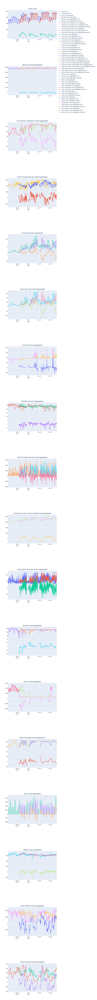

In [6]:
PslpData.plot_data()